In [1]:
import os
import json
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier


In [2]:
def load_annotations(annotations_folder):
    annotations = {}
    for filename in os.listdir(annotations_folder):
        if filename.endswith('.json'):
            with open(os.path.join(annotations_folder, filename)) as f:
                try:
                    data = json.load(f)
                    annotations[filename] = data
                except json.JSONDecodeError as e:
                    print(f"Error decoding JSON for file {filename}: {e}")
    return annotations

def parse_annotation(annotation):
    objects = annotation.get('objects', [])
    boxes = []
    labels = []
    for obj in objects:
        if obj.get('geometryType') == 'rectangle':
            label = obj.get('classTitle')
            exterior = obj.get('points', {}).get('exterior', [])
            if len(exterior) == 2:
                xmin, ymin = exterior[0]
                xmax, ymax = exterior[1]
                boxes.append([xmin, ymin, xmax, ymax])
                labels.append(label)
            else:
                print(f"Invalid exterior points in annotation: {exterior}")
        else:
            print(f"Invalid geometry type in annotation: {obj.get('geometryType')}")
    return boxes, labels

def extract_histogram(image, mask=None):
    hist = cv2.calcHist([image], [0, 1, 2], mask, [8, 8, 8], [0, 256, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

def prepare_features(images, boxes_list):
    features = []
    for img, boxes in zip(images, boxes_list):
        for box in boxes:
            xmin, ymin, xmax, ymax = box
            # Ensure ROI is within image dimensions
            if xmin >= 0 and ymin >= 0 and xmax <= img.shape[1] and ymax <= img.shape[0]:
                roi = img[ymin:ymax, xmin:xmax]
                hist = extract_histogram(roi)
                features.append(hist)
            else:
                print(f"Invalid bounding box: {box}")
    return features



In [3]:
def prepare_dataset(images_folder, annotations_folder):
    images = []
    boxes_list = []
    labels_list = []
    annotations = load_annotations(annotations_folder)
    
    for img_filename in os.listdir(images_folder):
        if img_filename.endswith('.jpeg') or img_filename.endswith('.jpg') or img_filename.endswith('.png'):
            img_path = os.path.join(images_folder, img_filename)
            annotation_filename = img_filename.replace('.jpeg', '.json').replace('.jpg', '.json').replace('.png', '.json')
            if annotation_filename in annotations:
                annotation = annotations[annotation_filename]
                boxes, labels = parse_annotation(annotation)
                image = cv2.imread(img_path)
                if image is not None:
                    images.append(image)
                    boxes_list.append(boxes)
                    labels_list.append(labels)
                else:
                    print(f"Error loading image: {img_path}")
            else:
                print(f"Annotation file not found for image: {img_filename}")
    
    return images, boxes_list, labels_list


In [4]:
annotations_folder = 'annotations'
images_folder = 'images'

images, boxes_list, labels_list = prepare_dataset(images_folder, annotations_folder)

print(f"Loaded {len(images)} images")
print(f"Loaded {len(boxes_list)} annotations")


Loaded 1300 images
Loaded 1300 annotations


In [5]:
# Define number of images to use for training
num_train = 1000

# Check if there are enough images
if len(images) >= num_train:
    train_images = images[:num_train]
    train_boxes = boxes_list[:num_train]
    train_labels = labels_list[:num_train]
    
    print(f"Using {num_train} images for training.")
else:
    print("Not enough images for training. Please check the dataset.")


Using 1000 images for training.


In [6]:
# Extract features from the training images
train_features = prepare_features(train_images, train_boxes)

# Flatten the labels for training
train_labels_flat = [0 if label == 'crop' else 1 for labels in train_labels for label in labels]

# Convert to NumPy arrays
X_train = np.array(train_features)
y_train = np.array(train_labels_flat)

print(f"Features and labels prepared for {len(X_train)} training samples.")



Features and labels prepared for 1570 training samples.


In [7]:
# Initialize the KNeighborsClassifier model
model = KNeighborsClassifier(n_neighbors=3)

# Train the model
model.fit(X_train, y_train)

print("Model trained successfully.")



Model trained successfully.


In [8]:

num_test = 300

if len(images) >= num_train + num_test:
    # Use the last 300 images for testing
    test_images = images[-num_test:]
    test_boxes = boxes_list[-num_test:]
    test_labels = labels_list[-num_test:]

    # Extract features from the test images
    test_features = prepare_features(test_images, test_boxes)

    # Flatten the labels for testing
    test_labels_flat = [0 if label == 'crop' else 1 for labels in test_labels for label in labels]

    # Convert to NumPy arrays
    X_test = np.array(test_features)
    y_test = np.array(test_labels_flat)

    # Evaluate the classifier
    accuracy = model.score(X_test, y_test)
    print(f"Accuracy: {accuracy * 100:.2f}%")
else:
    print("Not enough data to evaluate the model. Please check the dataset.")


Accuracy: 97.01%


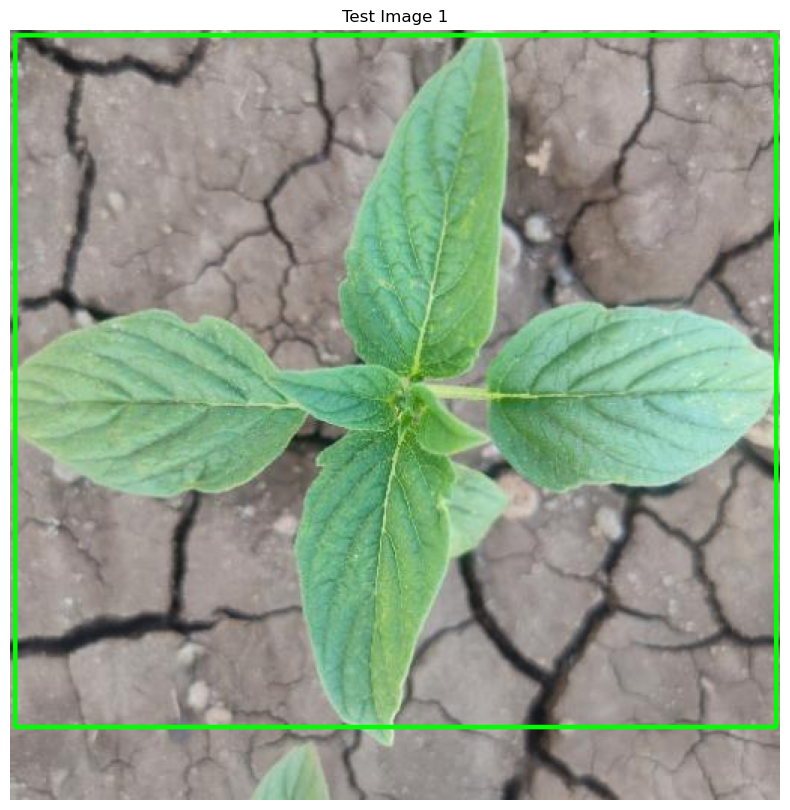

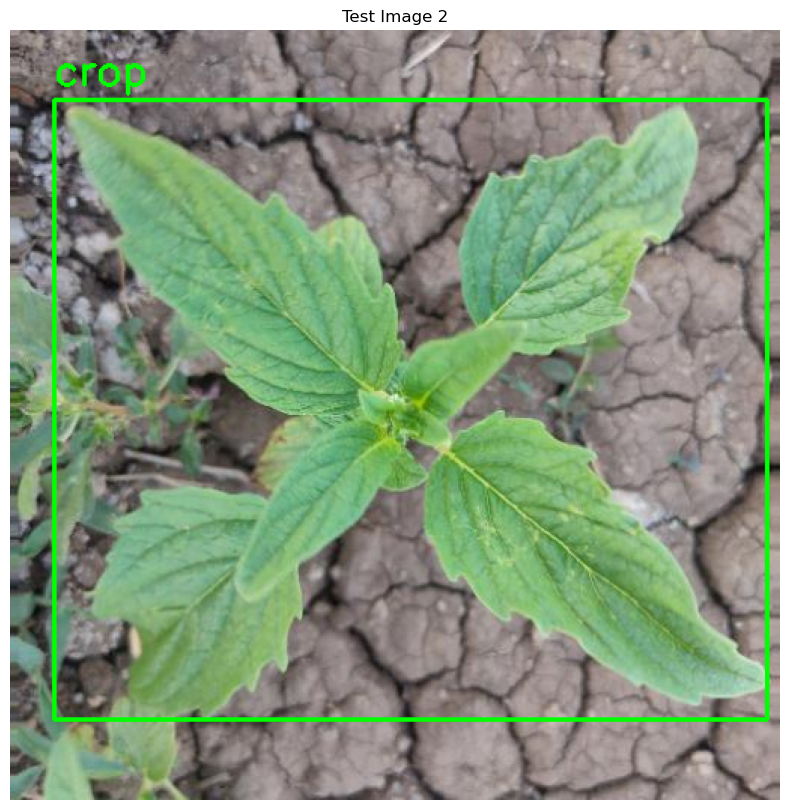

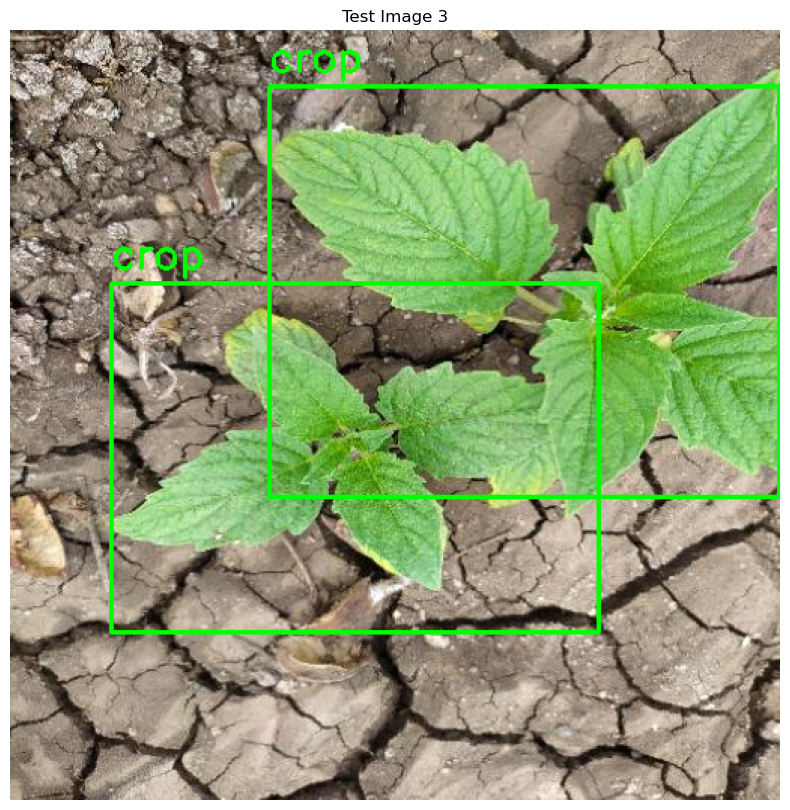

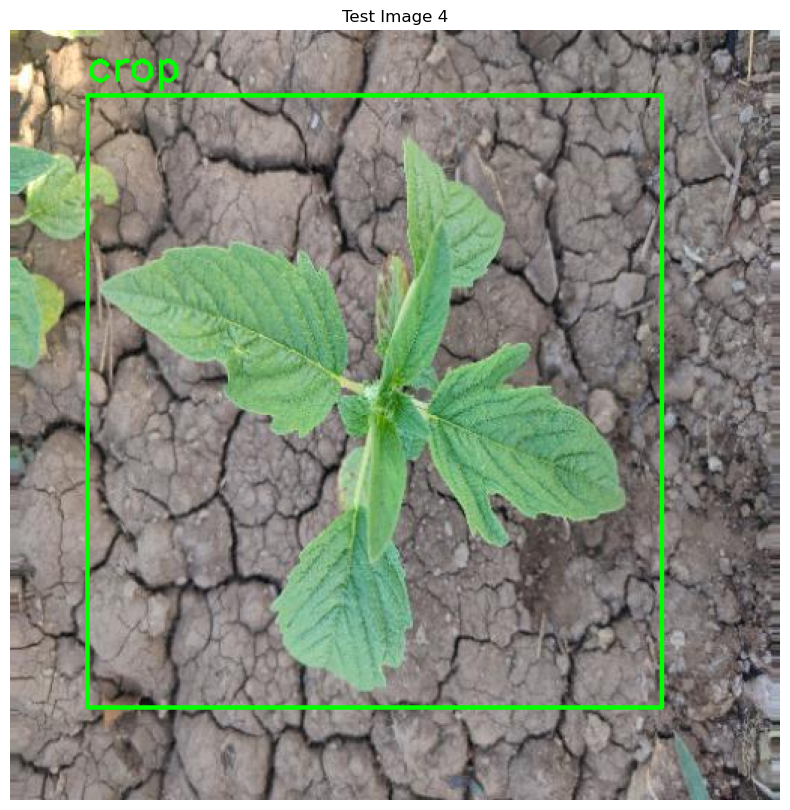

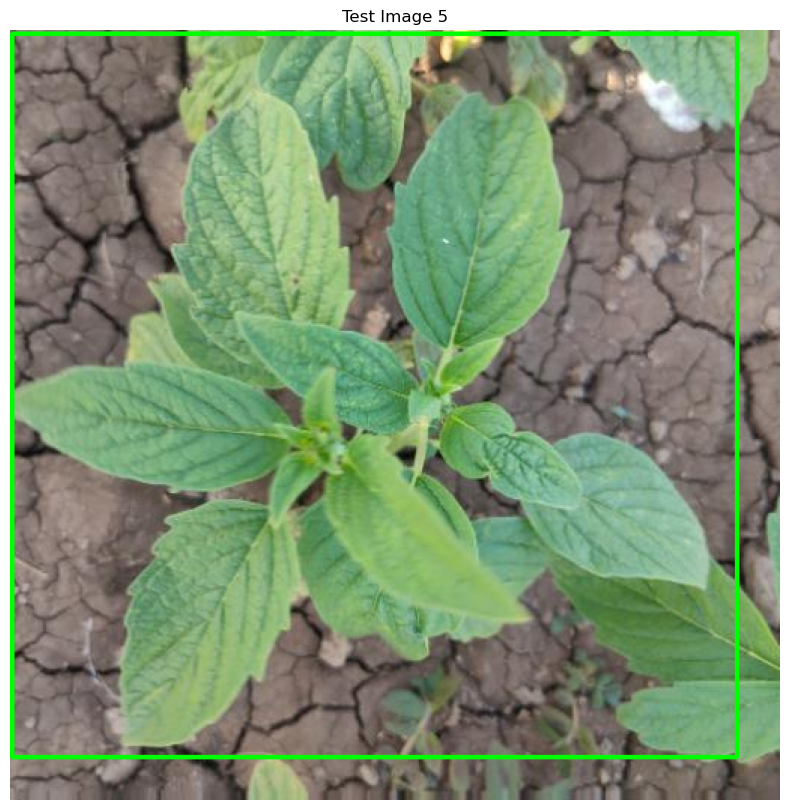

...

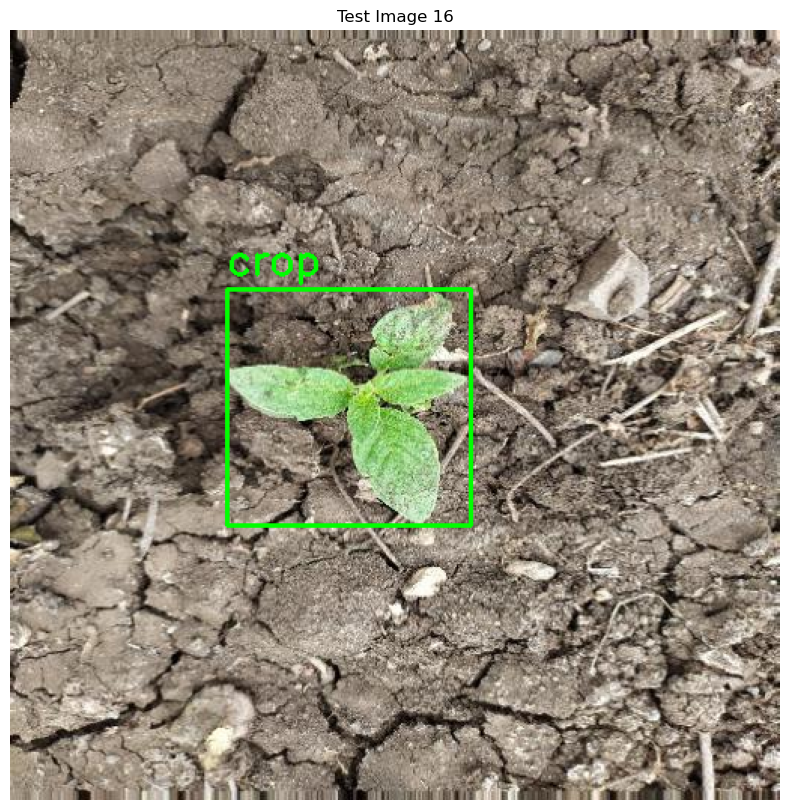

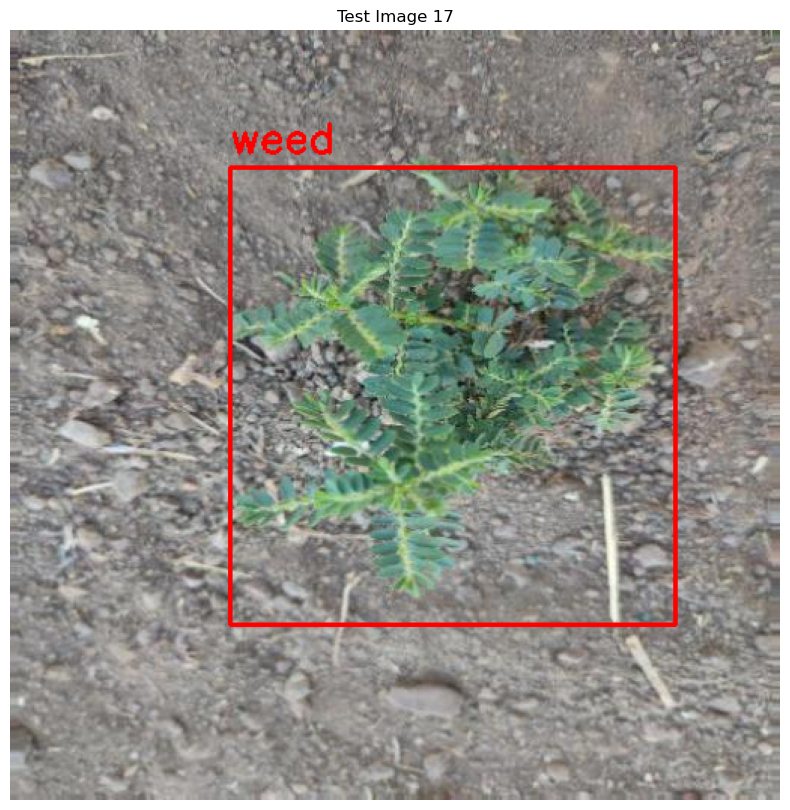

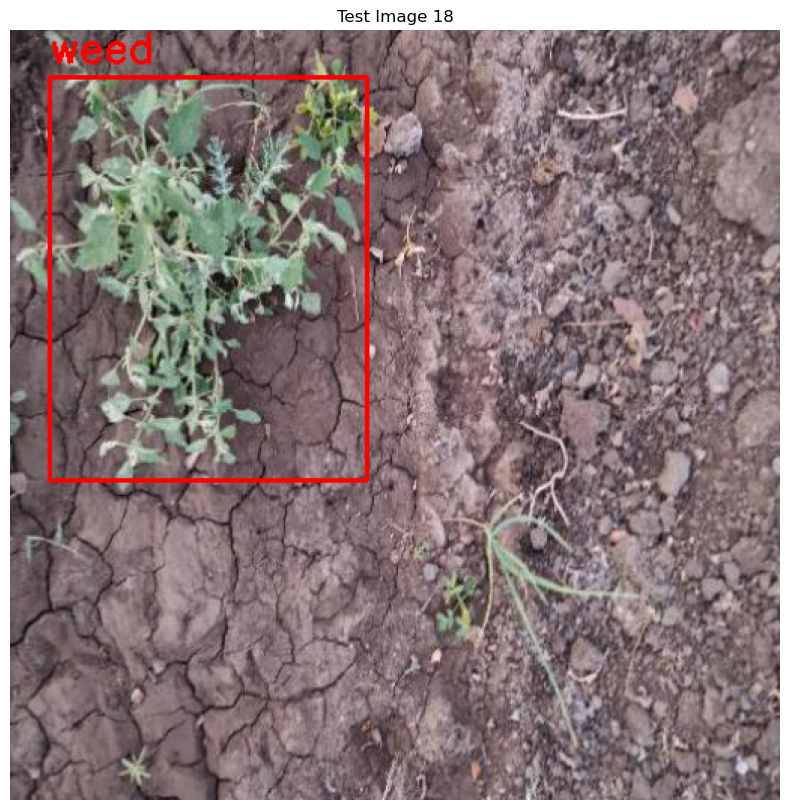

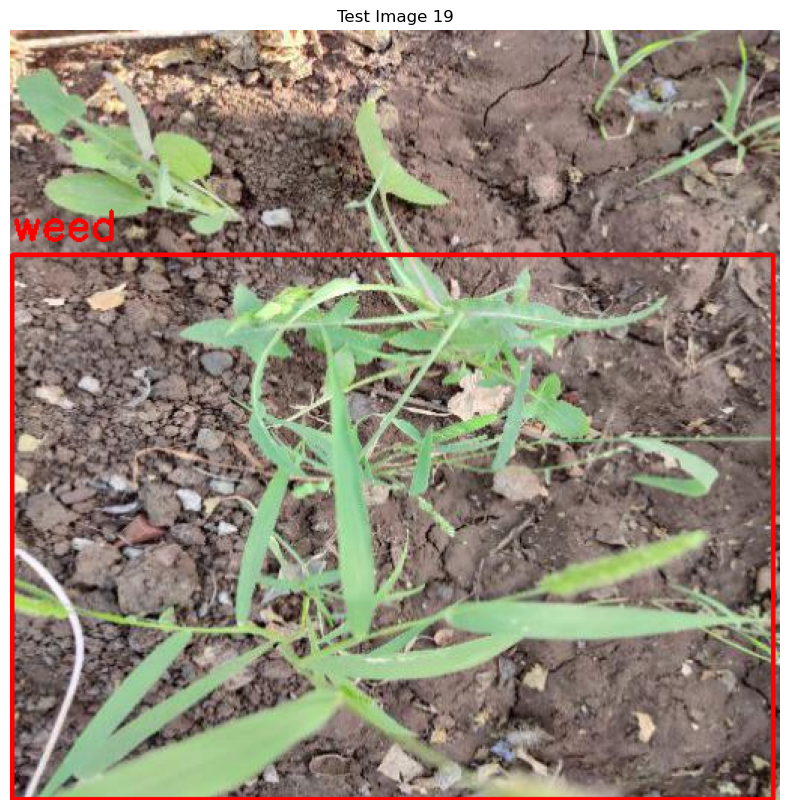

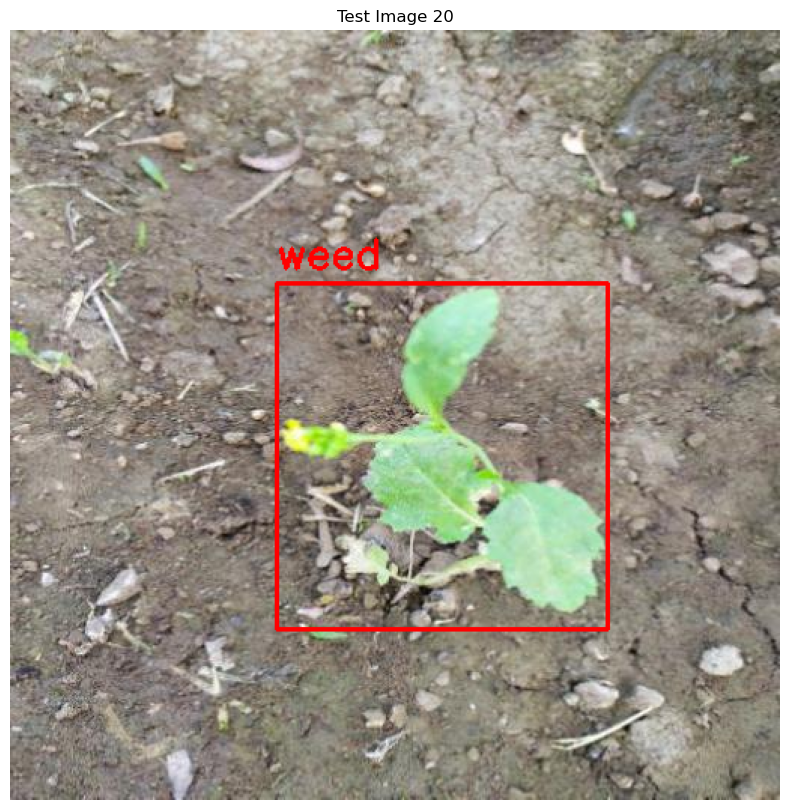

In [9]:
import matplotlib.pyplot as plt
import cv2

def visualize_detections(image, detections):
    for box, label in detections:
        xmin, ymin, xmax, ymax = box
        color = (0, 255, 0) if label == 0 else (0, 0, 255)  # Green for crop, Red for weed
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), color, 2)
        cv2.putText(image, 'crop' if label == 0 else 'weed', (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    return image

def detect_objects(image, boxes, model):
    results = []
    for box in boxes:
        xmin, ymin, xmax, ymax = box
        roi = image[ymin:ymax, xmin:xmax]
        hist = extract_histogram(roi)
        hist = hist.reshape(1, -1)
        label = model.predict(hist)
        results.append((box, label[0]))
    return results

# Display only the first 20 test images with detections
for i, image in enumerate(test_images[:20]):  # Only process the first 20 images
    detections = detect_objects(image, test_boxes[i], model)
    image_with_detections = visualize_detections(image.copy(), detections)
    
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image_with_detections, cv2.COLOR_BGR2RGB))
    plt.title(f"Test Image {i + 1}")
    plt.axis('off')
    plt.show()


In [ ]:
# Define the folder containing new images
new_images_folder = 'images10'

# Load new images
def load_new_images(images_folder):
    images = []
    for img_filename in os.listdir(images_folder):
        if img_filename.endswith('.jpeg') or img_filename.endswith('.jpg') or img_filename.endswith('.png'):
            img_path = os.path.join(images_folder, img_filename)
            image = cv2.imread(img_path)
            if image is not None:
                images.append(image)
            else:
                print(f"Error loading image: {img_path}")
    return images

new_images = load_new_images(new_images_folder)
print(f"Loaded {len(new_images)} new images")


In [ ]:
def predict_image(image, model):
    detections = []
    height, width = image.shape[:2]
    
    # Example object detection method (replace with your actual method)
    step_size = 64  # Example step size for sliding window
    window_size = 128  # Example window size
    
    for y in range(0, height - window_size, step_size):
        for x in range(0, width - window_size, step_size):
            box = [x, y, x + window_size, y + window_size]
            xmin, ymin, xmax, ymax = box
            roi = image[ymin:ymax, xmin:xmax]
            hist = extract_histogram(roi)
            hist = hist.reshape(1, -1)
            predicted_label = model.predict(hist)
            
            if predicted_label[0] == 1:  # Assuming 1 is the label for 'weed'
                detections.append((box, predicted_label[0]))
    return detections


In [ ]:
def visualize_detections(image, detections):
    for box, label in detections:
        xmin, ymin, xmax, ymax = box
        color = (0, 255, 0) if label == 0 else (0, 0, 255)  # Green for crop, Red for weed
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), color, 2)
        cv2.putText(image, 'crop' if label == 0 else 'weed', (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)
    return image



In [ ]:
for i, image in enumerate(new_images[:20]):
    detections = predict_image(image, model)
    image_with_detections = visualize_detections(image.copy(), detections)
    
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image_with_detections, cv2.COLOR_BGR2RGB))
    plt.title(f"New Image {i + 1}")
    plt.axis('off')
    plt.show()


In [ ]:
import cv2

def predict_image_with_yolo(image, yolo_model):
    height, width = image.shape[:2]
    
    # Preprocess image as required by YOLO model
    blob = cv2.dnn.blobFromImage(image, scalefactor=1/255.0, size=(416, 416))
    yolo_model.setInput(blob)
    outputs = yolo_model.forward()
    
    detections = []
    
    for output in outputs:
        for detection in output:
            # Parse detection results
            confidence = detection[4]
            if confidence > 0.5:  # Confidence threshold
                bbox = detection[:4] * np.array([width, height, width, height])
                xmin, ymin, xmax, ymax = bbox.astype(int)
                detections.append(([xmin, ymin, xmax, ymax], 1))  # 1 for 'weed'
    
    return detections
